# Introduction
This notebook focuses on audio data processing, feature extraction, and exploratory data analysis.

# Setup
Importing necessary libraries and setting up configurations.

In [1]:
from scipy.signal import iirfilter, sosfreqz, sosfilt
import librosa
import numpy as np 
import pandas as pd 
import random
import pathlib
from tqdm import tqdm
import seaborn as sns
import matplotlib.pyplot as plt
import librosa as lib
import librosa.display
import os
from IPython.display import Audio


# Data Loading
Setting up data directories, defining functions to get file paths, and loading audio files.


## Inferences and Suggestions (Exploratory Data Analysis)

### Number of Audio Files for Each Speaker
- **Inference**: The dataset should be balanced to prevent any bias towards a specific speaker during model training.
- **Suggestion**: If there is a significant imbalance, consider augmenting the data for speakers with fewer audio files or using techniques to handle imbalanced data.

### Audio Waveform, Spectrogram, and MFCC
- **Inference**: These visualizations help in understanding the impact of preprocessing steps on the audio data. It is crucial to observe how denoising and other preprocessing steps affect the audio quality and the extracted features.
- **Suggestion**: Ensure that important information is not lost during preprocessing. The effectiveness of the preprocessing steps should be evident in enhancing audio quality without removing essential features.


In [2]:
data_dir = "16000_pcm_speeches/"
os.listdir(data_dir)

['Benjamin_Netanyau',
 'Jens_Stoltenberg',
 'Julia_Gillard',
 'Magaret_Tarcher',
 'Nelson_Mandela',
 'other',
 'tf_Wav_reader.py',
 '_background_noise_']

In [3]:
def get_wav_paths(speaker):
    speaker_path = data_dir + speaker
    all_paths = [item for item in os.listdir(speaker_path)]
    return all_paths

In [4]:
nelson_mandela_paths = get_wav_paths("Nelson_Mandela")
margaret_thatcher_paths = get_wav_paths("Magaret_Tarcher")
benjamin_netanyau_paths = get_wav_paths("Benjamin_Netanyau")
jens_stoltenberg_paths = get_wav_paths("Jens_Stoltenberg")
julia_gillard_paths = get_wav_paths("Julia_Gillard")

noise1_paths = get_wav_paths("_background_noise_")
noise2_paths = get_wav_paths("other")

In [5]:
def load_wav(wav_path, speaker, sample_rate=16000):
    wav_path = data_dir + speaker + "/" + wav_path
    wav_data, _ = librosa.load(wav_path, sr=sample_rate, mono=True)
    wav_data = np.reshape(wav_data, (1, -1))
    return wav_data

In [6]:

data_raw = []
data_processed = []

base_path = "16000_pcm_speeches"
speakers = ["Benjamin_Netanyau", "Jens_Stoltenberg", "Julia_Gillard", "Magaret_Tarcher", "Nelson_Mandela"]


# Data Preprocessing
Defining functions for audio denoising and performing various audio processing tasks.

In [7]:
def generate_training_data(speaker_paths, speaker, label):
    wavs, labels = [], []
    for i in tqdm(speaker_paths):
        wav = load_wav(i, speaker)
        wavs.append(wav)
        labels.append(label)
    return wavs, labels

In [8]:
nelson_mandela_wavs, nelson_mandela_labels = generate_training_data(nelson_mandela_paths, "Nelson_Mandela", 0) 
margaret_thatcher_wavs, margaret_thatcher_labels = generate_training_data(margaret_thatcher_paths, "Magaret_Tarcher", 1) 
benjamin_netanyau_wavs, benjamin_netanyau_labels = generate_training_data(benjamin_netanyau_paths, "Benjamin_Netanyau", 2) 
jens_stoltenberg_wavs, jens_stoltenberg_labels = generate_training_data(jens_stoltenberg_paths, "Jens_Stoltenberg", 3) 
julia_gillard_wavs, julia_gillard_labels = generate_training_data(julia_gillard_paths, "Julia_Gillard", 4) 

100%|██████████| 1501/1501 [00:00<00:00, 2718.33it/s]


In [9]:
julia_gillard_labels = julia_gillard_labels[1:]
julia_gillard_wavs = julia_gillard_wavs[1:]

In [10]:
# Function to denoise audio using D1 method
def denoise_method_d1(y):
    D = lib.stft(y)
    magnitude, phase = lib.magphase(D)
    magnitude_denoised = lib.decompose.nn_filter(magnitude, aggregate=np.median, metric='cosine')
    y_denoised = lib.istft(magnitude_denoised * phase)
    return y_denoised

In [11]:
# Function to denoise audio using spectral method
def denoise_method_spectral(y, sr):
    # Calculate spectral centroid
    cent = np.mean(lib.feature.spectral_centroid(y=y, sr=sr))

    # Low-shelf
    sos = iirfilter(N=2, Wn=cent/sr, btype='low', ftype='butter', output='sos')
    y_low_shelf = sosfilt(sos, y)

    # High-shelf
    sos = iirfilter(N=2, Wn=cent/sr, btype='high', ftype='butter', output='sos')
    y_high_shelf = sosfilt(sos, y_low_shelf)

    # Amplify signal to compensate for volume reduction
    y_denoised = y_high_shelf * 10
    return y_denoised


# Exploratory Data Analysis
Analyzing and visualizing audio data.

In [12]:
for speaker in speakers:
    speaker_path = os.path.join(base_path, speaker)
    audio_files = [f for f in os.listdir(speaker_path) if f.endswith(".wav")]
    num_audio_files = len(audio_files)
    data_raw.append([speaker, num_audio_files])

df_speaker_counts = pd.DataFrame(data_raw, columns=['Speaker', 'Count'])


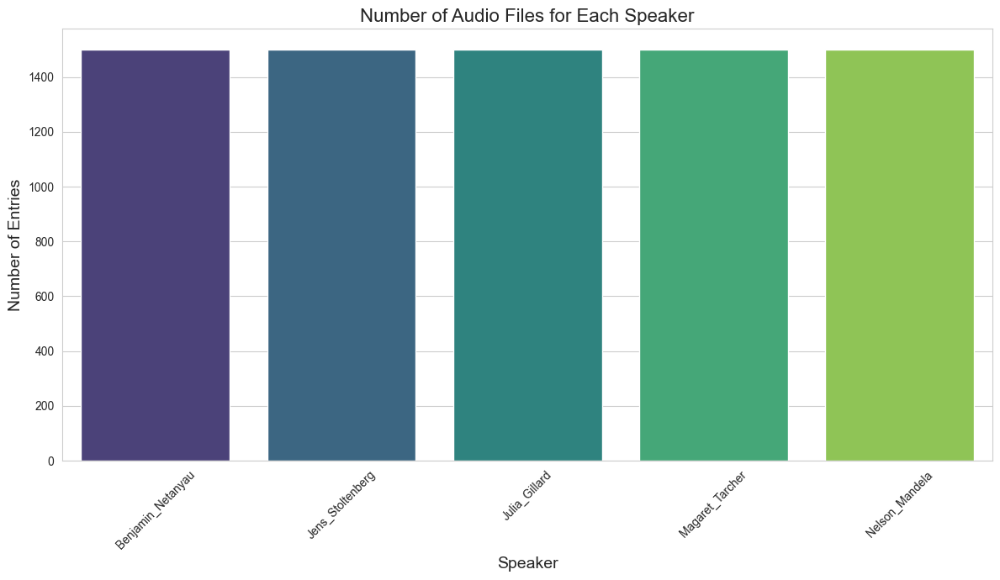

In [13]:
#histogram

plt.figure(figsize=(12, 7))
sns.set_style("whitegrid")
sns.barplot(data=df_speaker_counts, x='Speaker', y='Count', palette='viridis', edgecolor='w', hue = 'Speaker')
plt.title('Number of Audio Files for Each Speaker', fontsize=16)
plt.xlabel('Speaker', fontsize=14)
plt.ylabel('Number of Entries', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [14]:
def plot_audio_wave(y, sr, title=""):
    plt.figure(figsize=(10, 4)) 
    lib.display.waveshow(y, sr=sr)
    plt.title('Waveform - ' + title)
    plt.tight_layout()
    plt.show()

def plot_audio_wave_spect(y, sr, title=""):
    plt.figure(figsize=(10, 4))    
    # Spectrogram
    D = lib.amplitude_to_db(np.abs(lib.stft(y)), ref=np.max)
    lib.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(label='dB')
    plt.title('Spectrogram - ' + title)
    plt.tight_layout()
    plt.show()

def plot_audio_wave_mfcc(y, sr, title=""):
    plt.figure(figsize=(10, 4)) 
    # MFCC
    M = lib.feature.mfcc(y=y, sr=sr)
    lib.display.specshow(M, sr=sr, x_axis='time')
    plt.colorbar()
    plt.title('MFCC - ' + title)
    plt.tight_layout()
    plt.show()

Processing audio from class: Benjamin_Netanyau


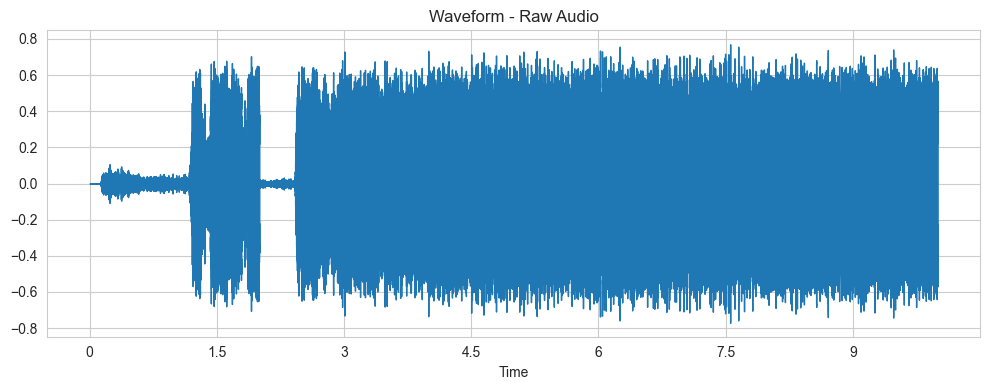

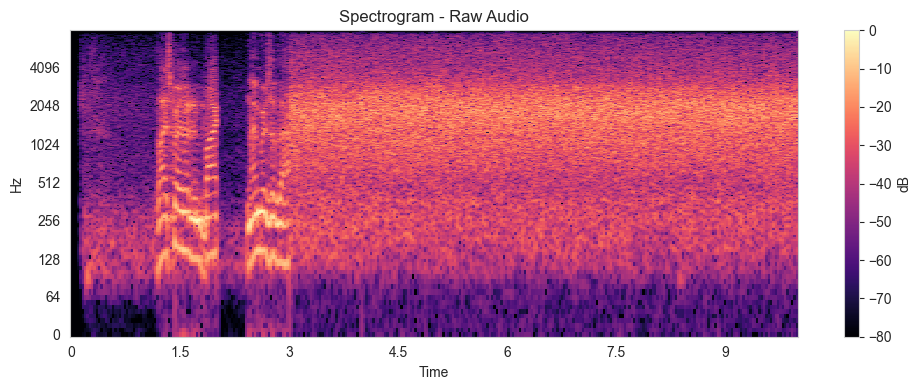

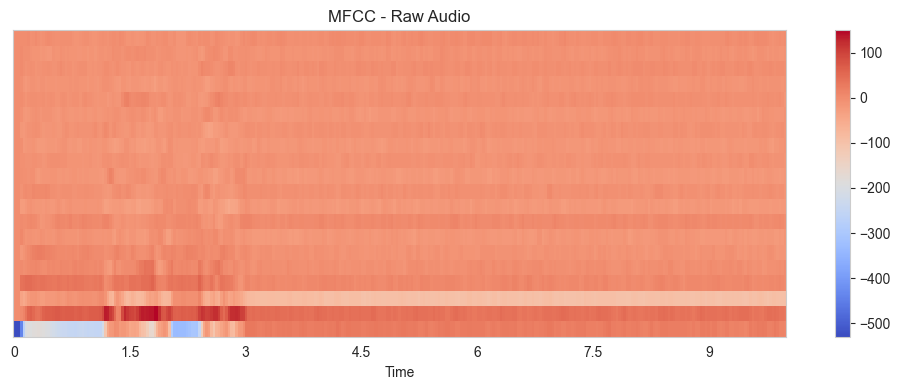

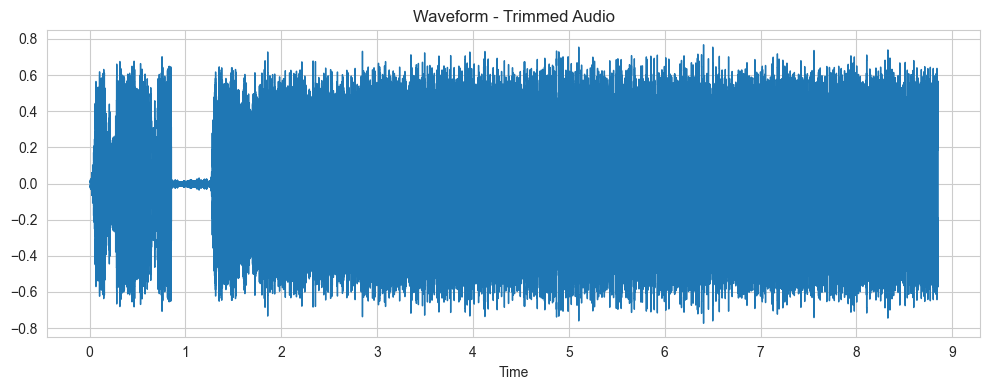

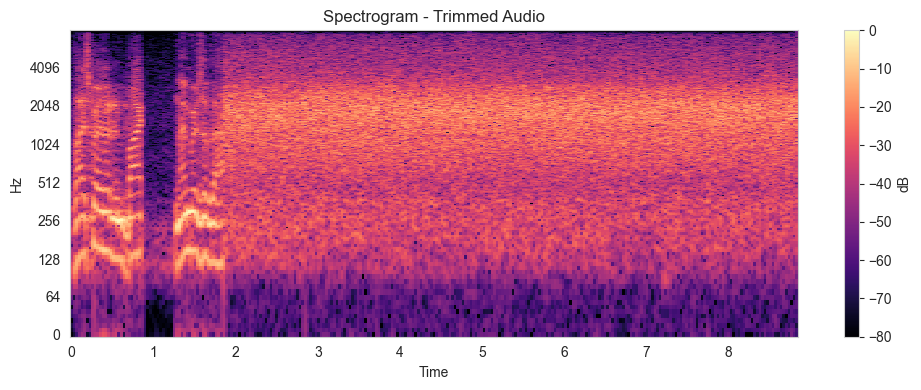

...

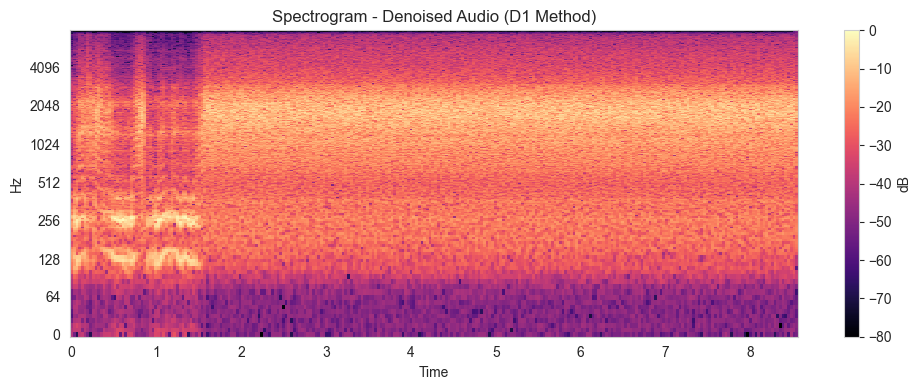

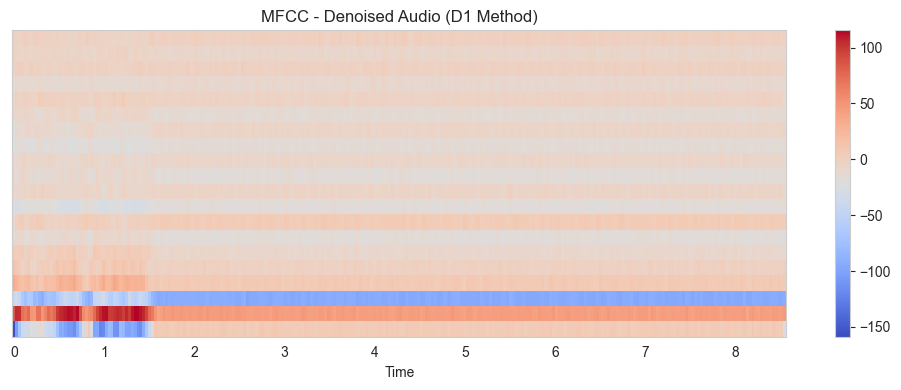

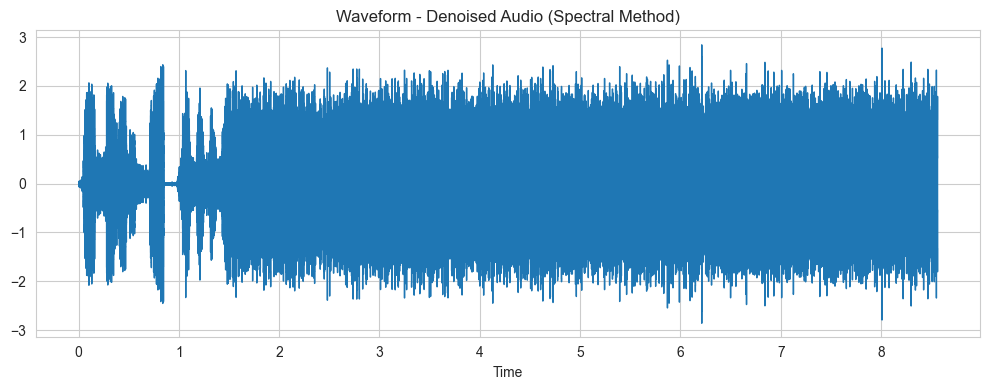

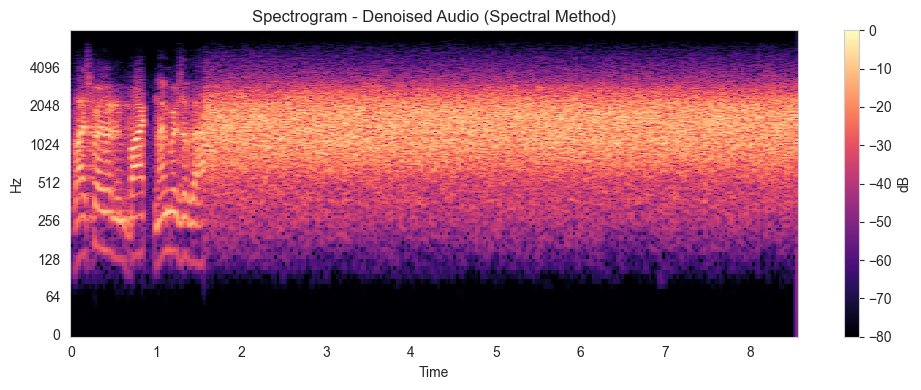

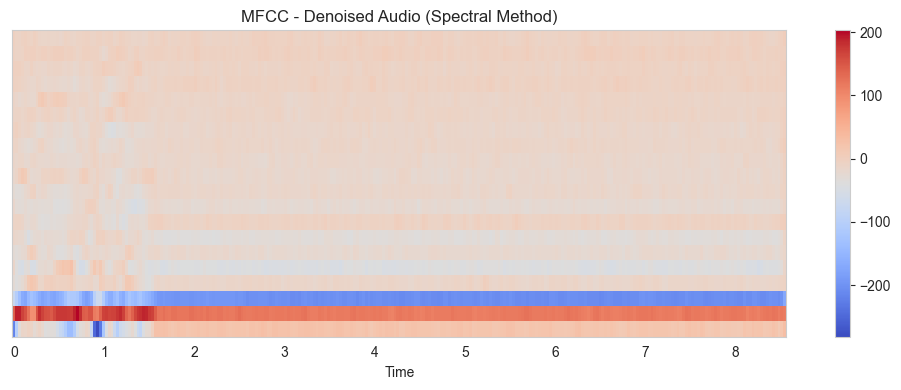

Processing audio from class: Jens_Stoltenberg


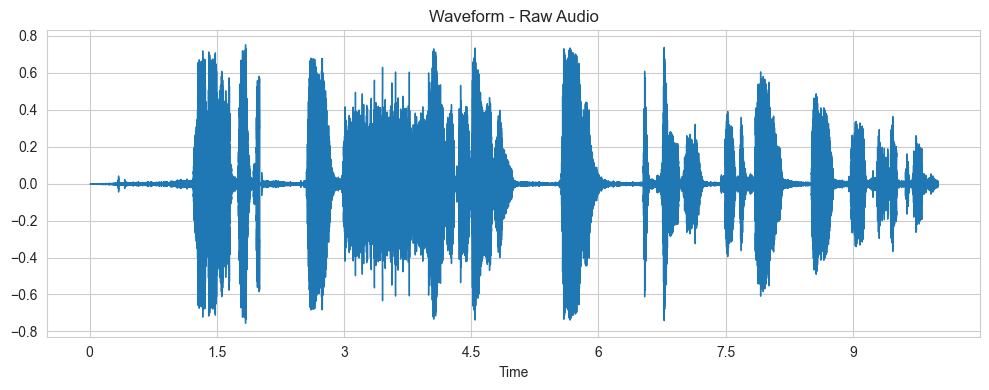

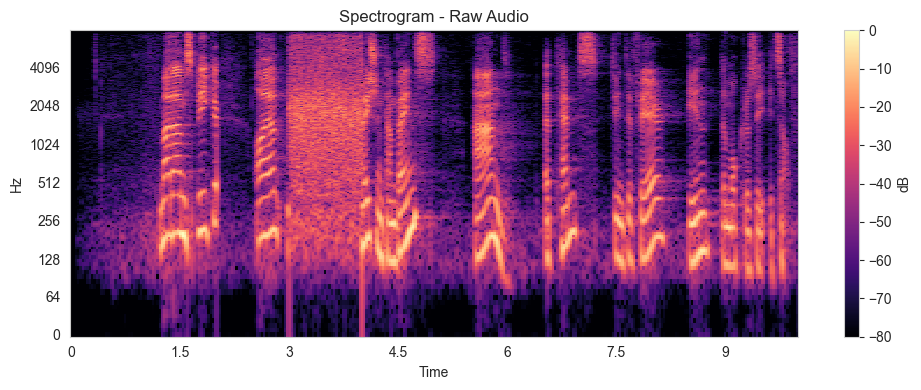

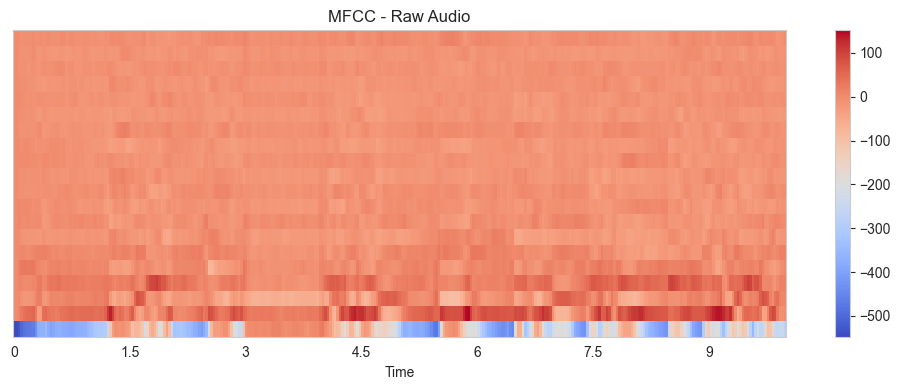

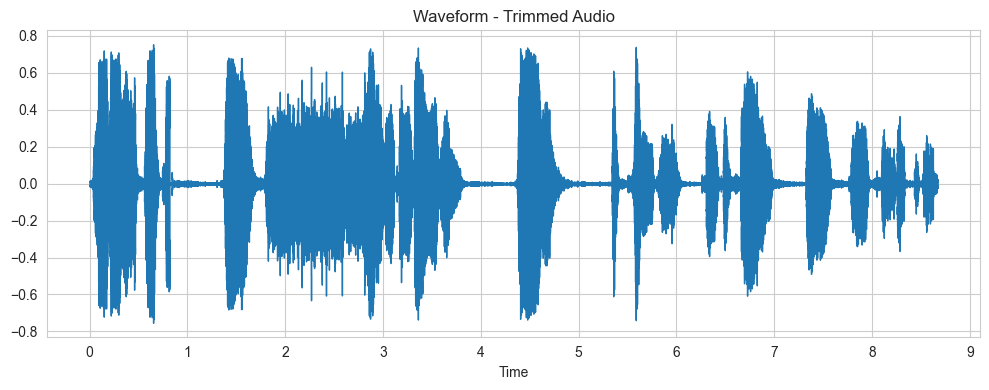

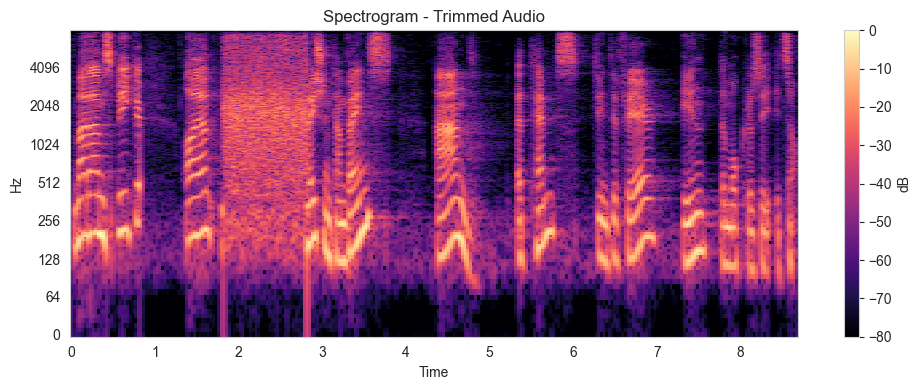

...

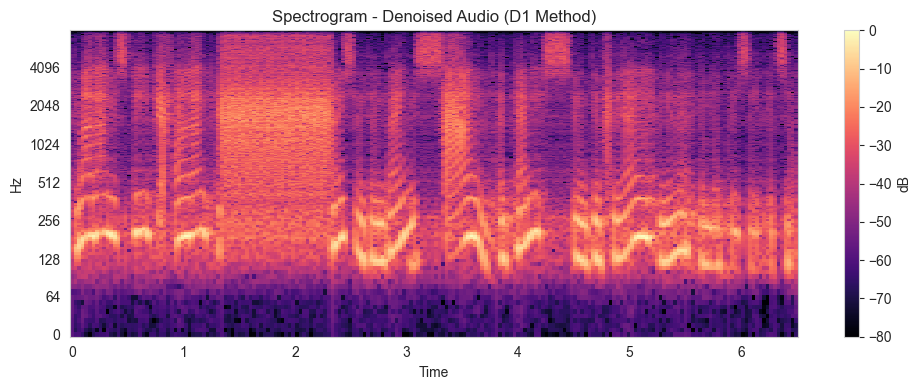

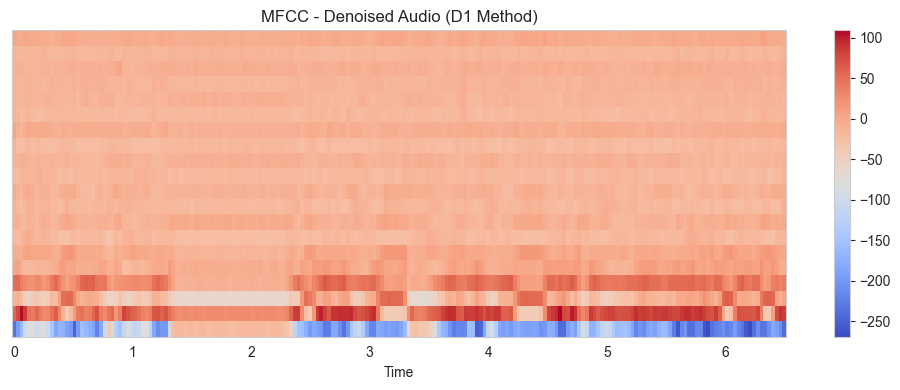

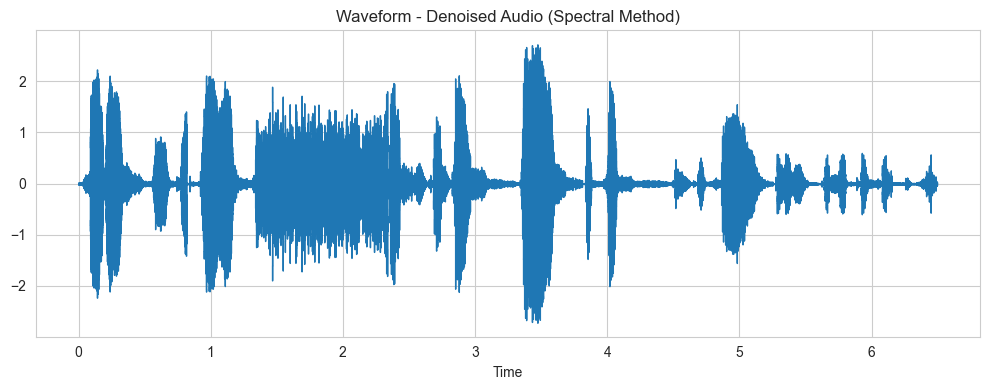

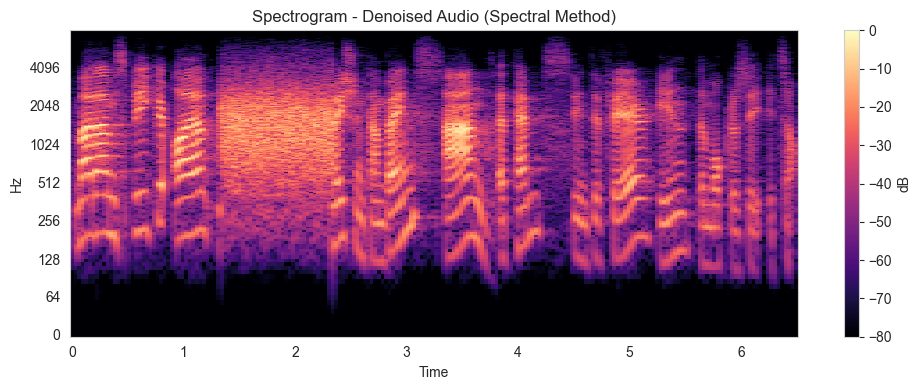

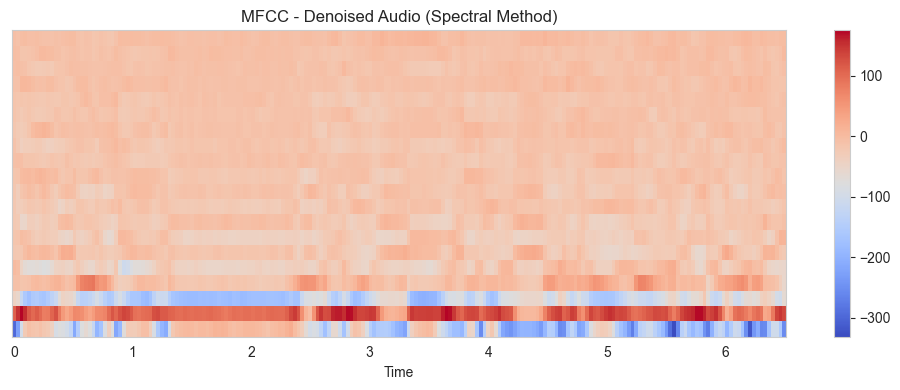

Processing audio from class: Julia_Gillard


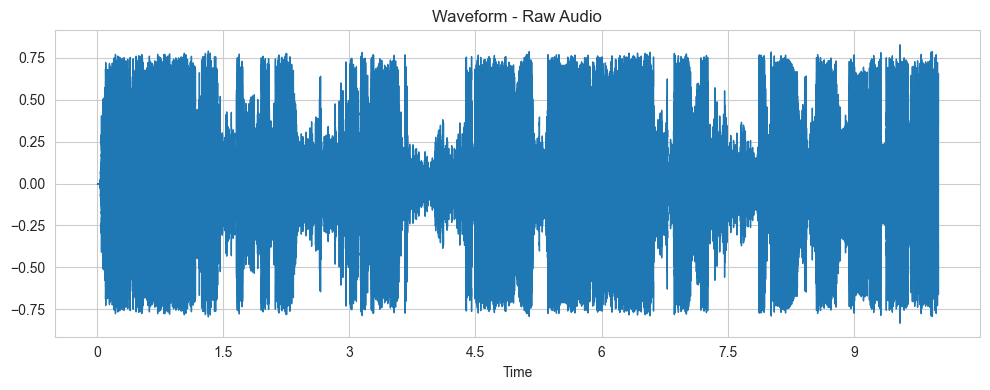

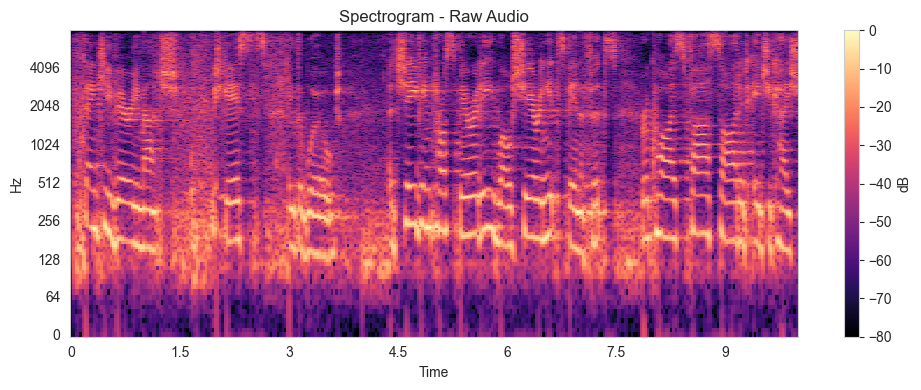

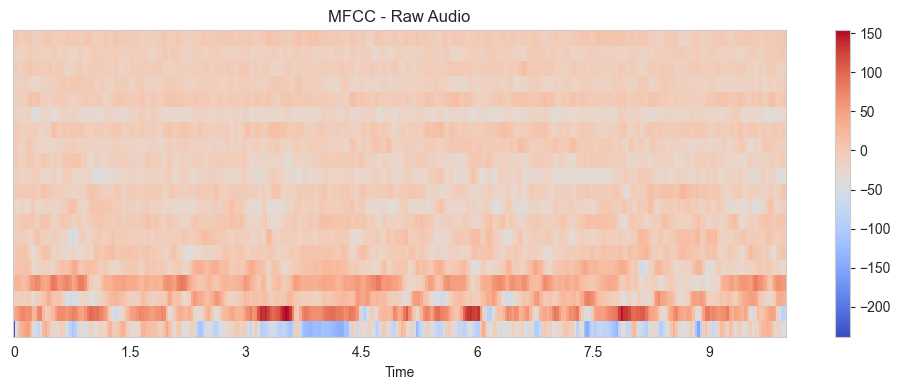

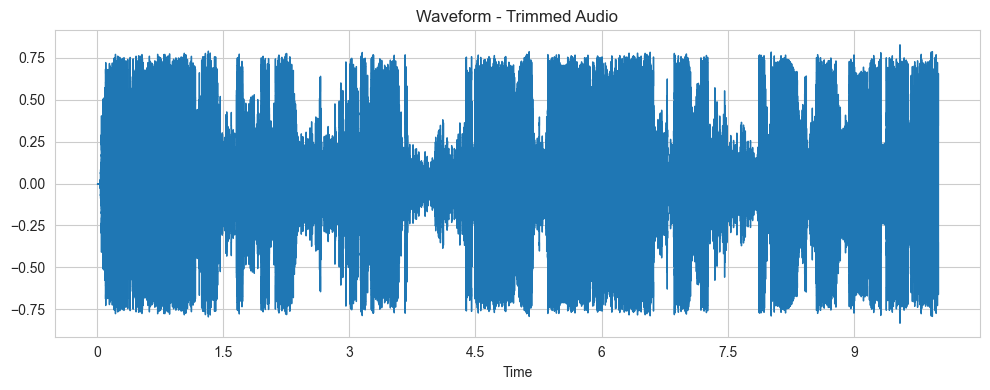

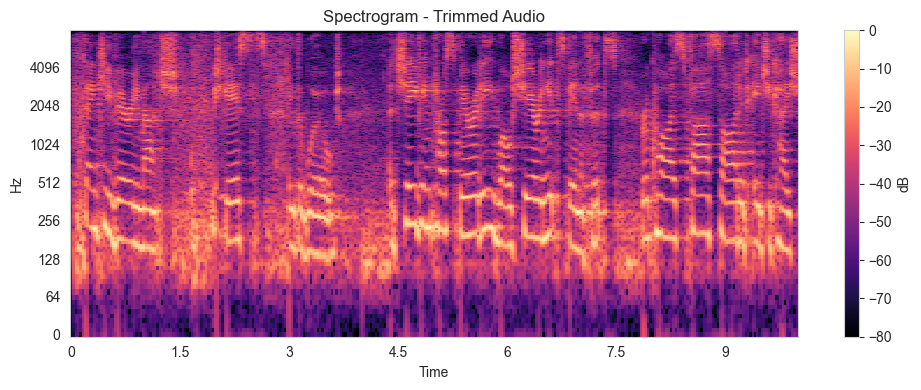

...

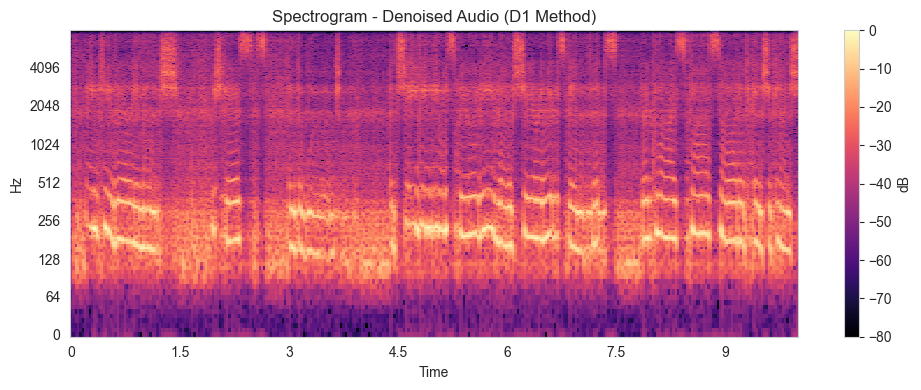

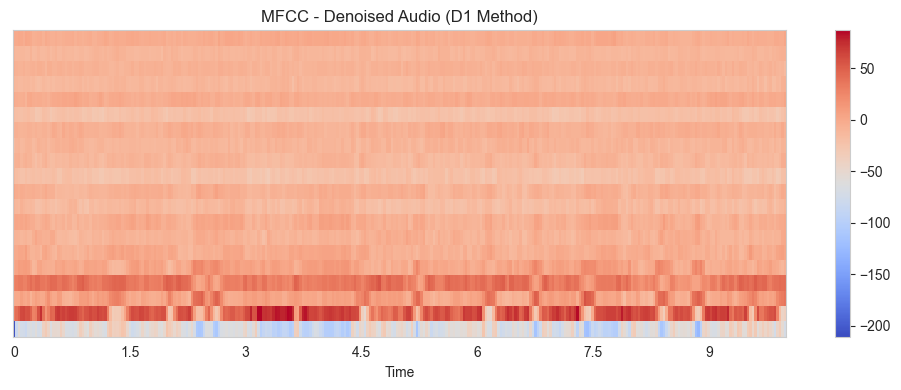

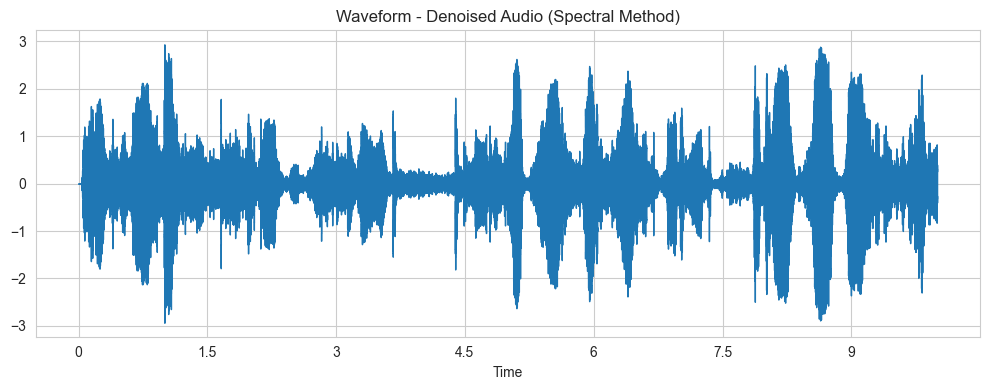

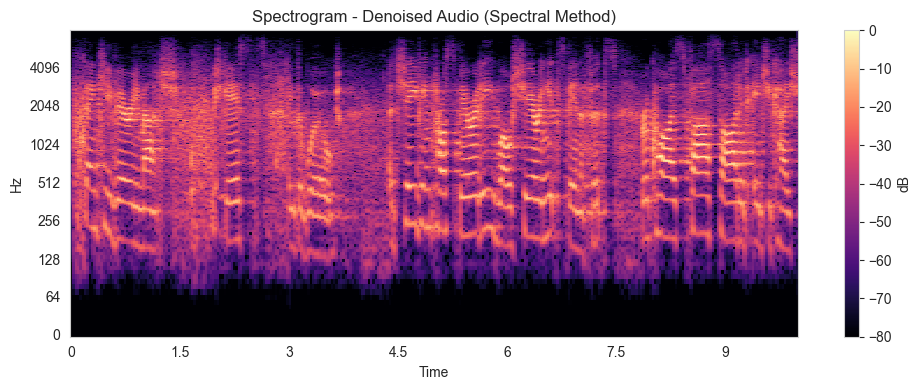

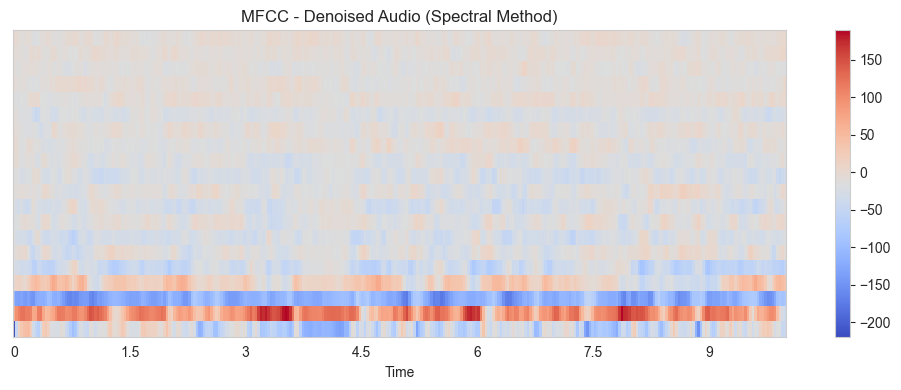

Processing audio from class: Magaret_Tarcher


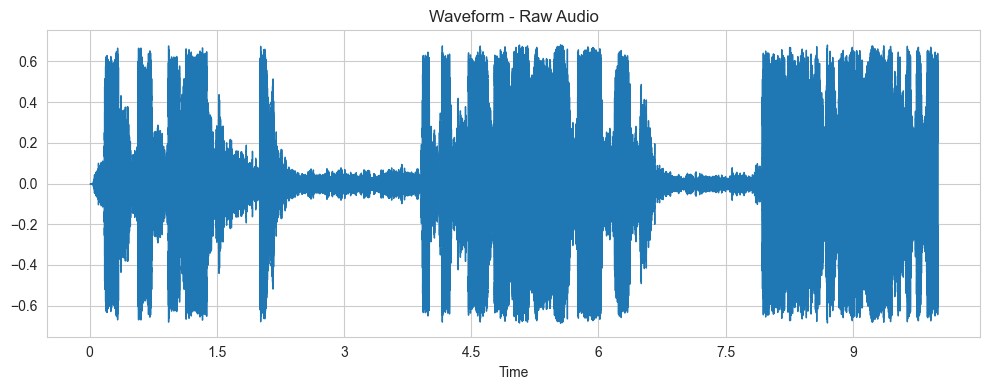

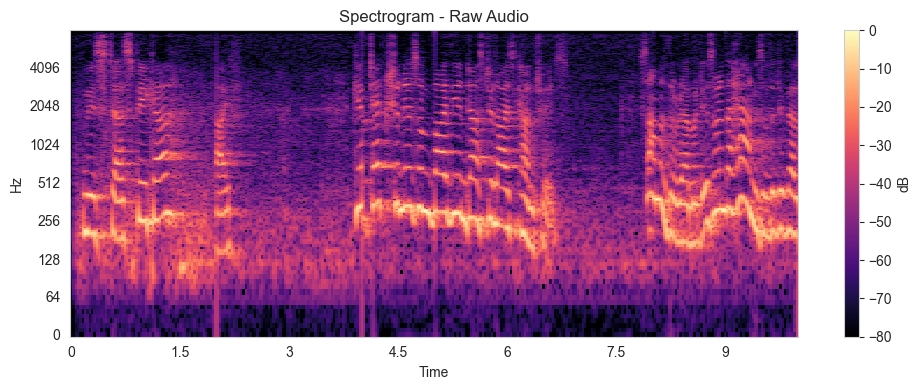

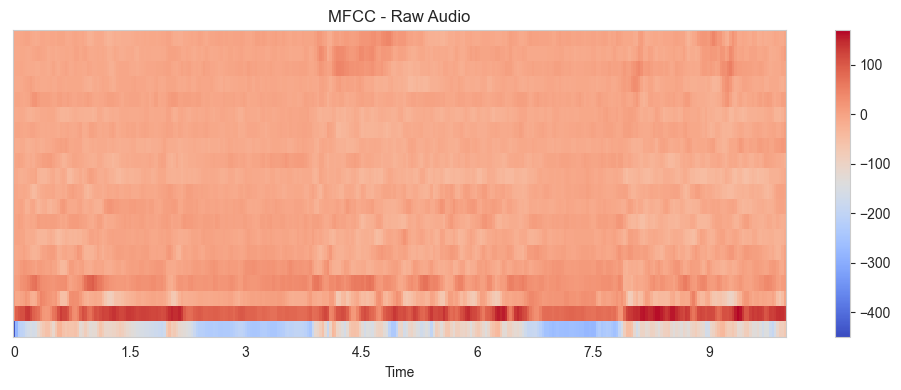

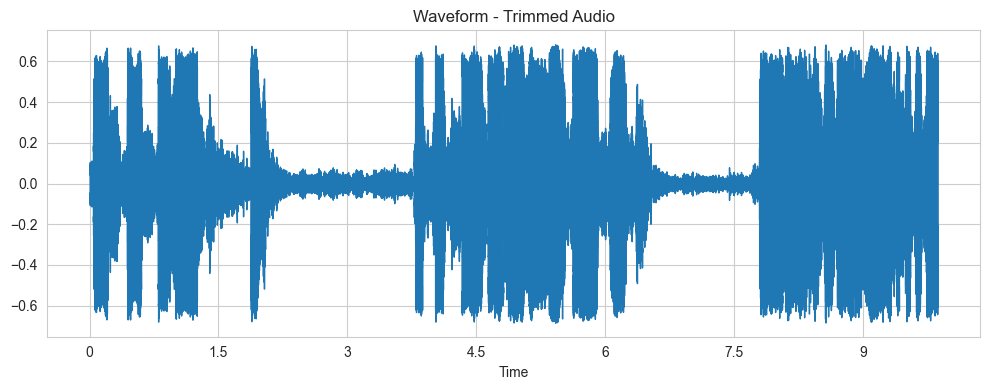

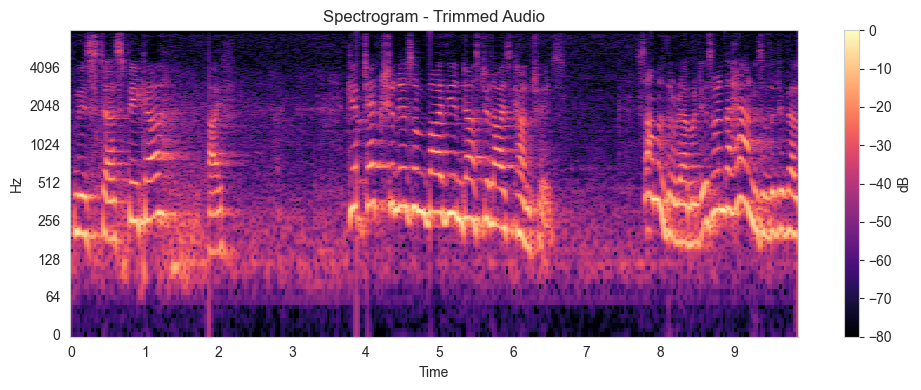

...

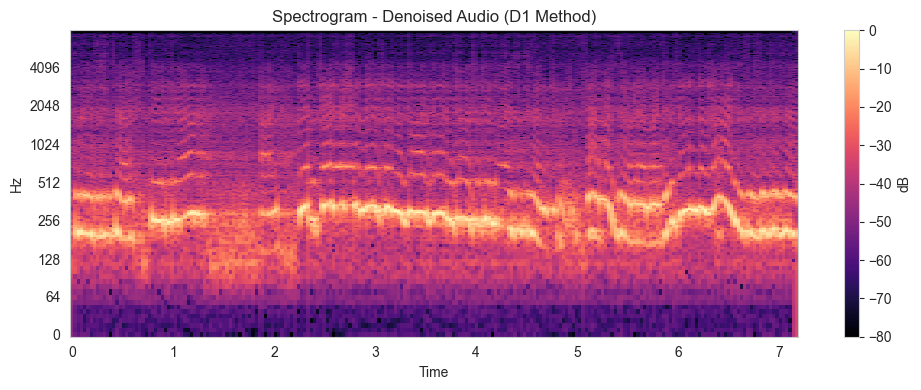

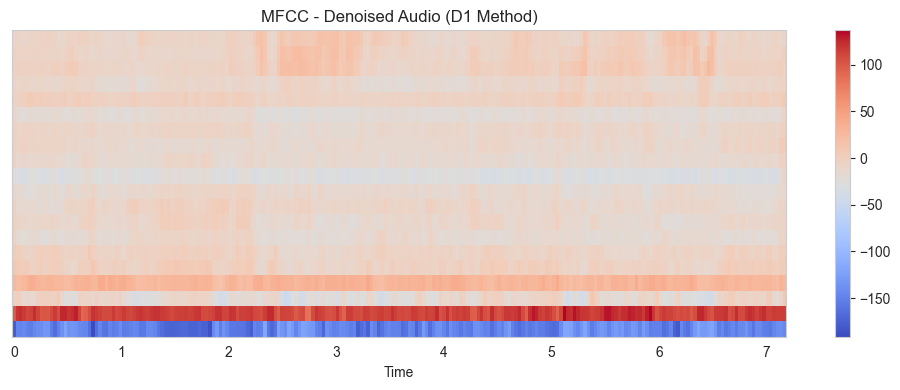

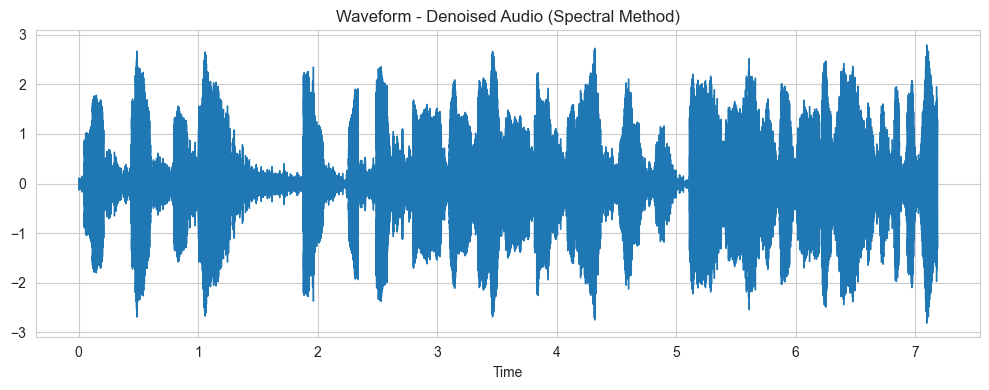

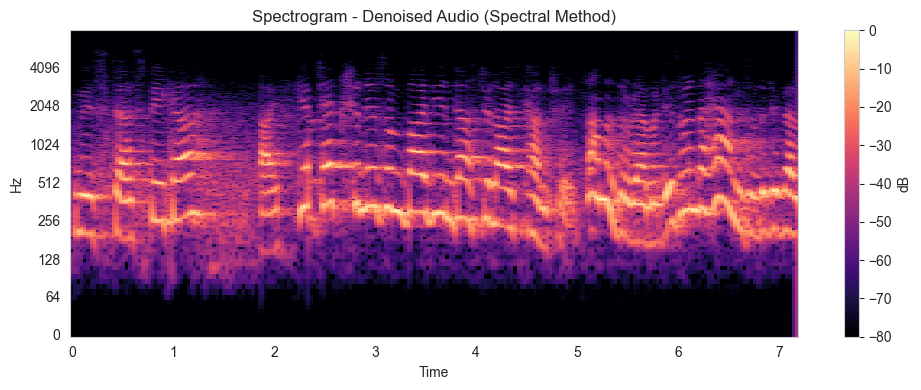

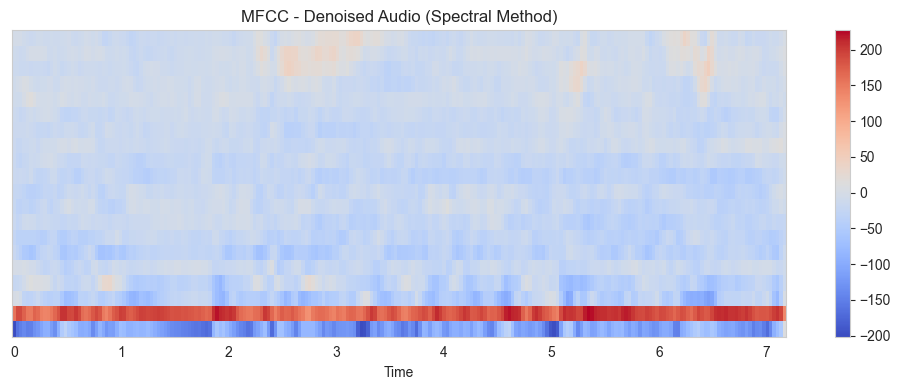

Processing audio from class: Nelson_Mandela


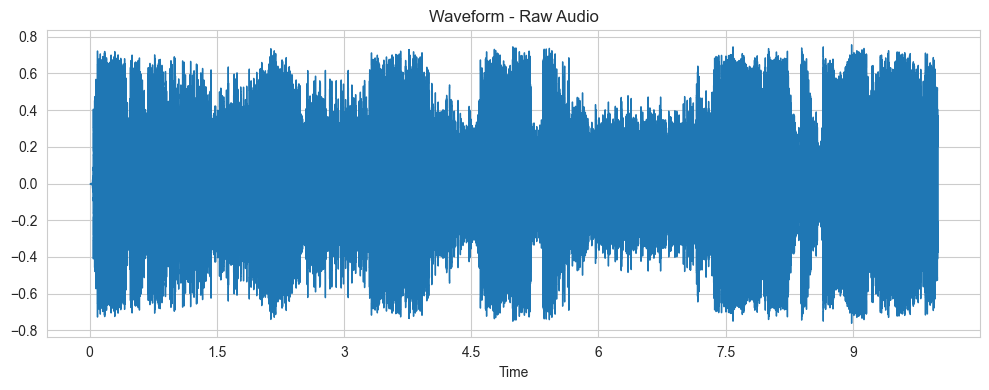

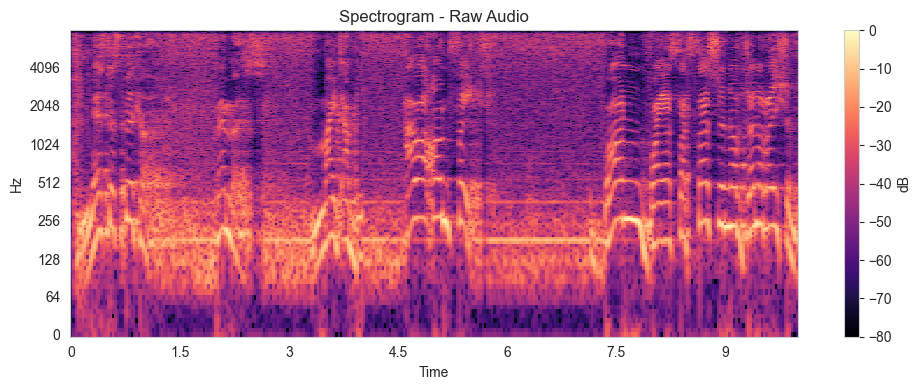

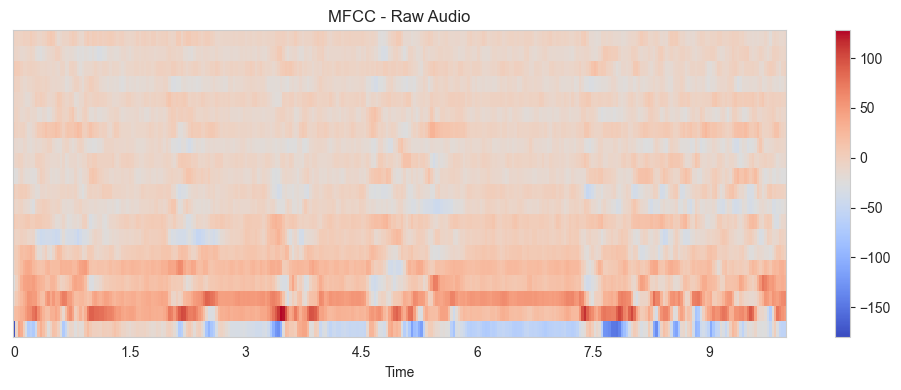

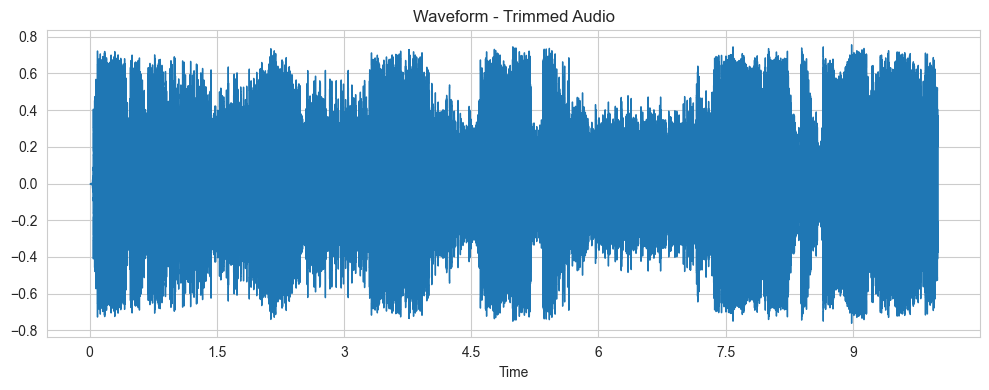

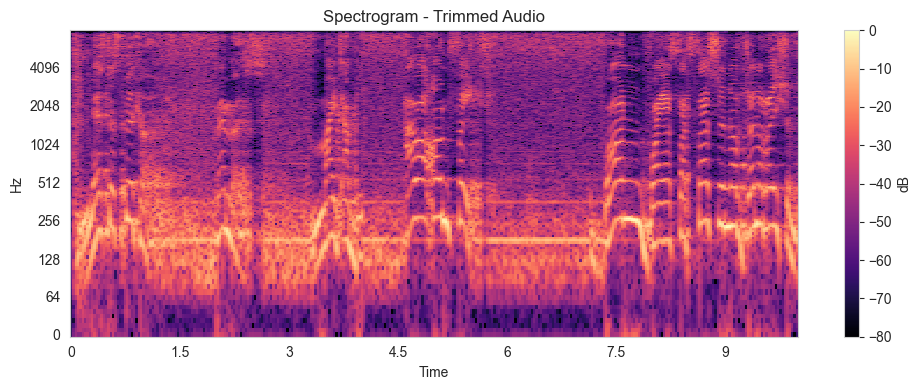

...

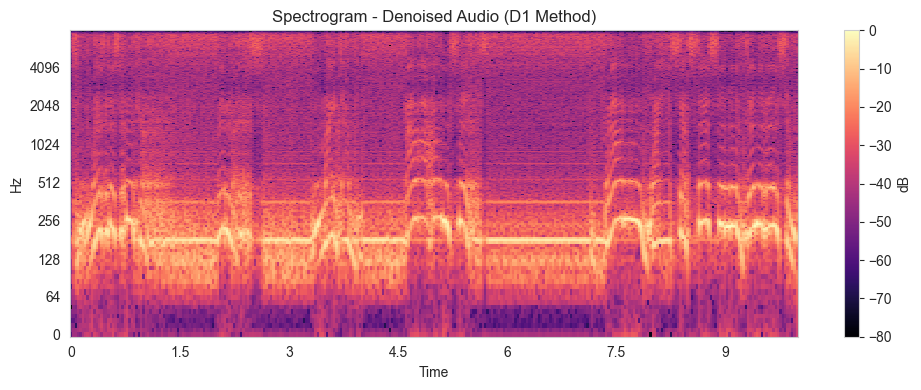

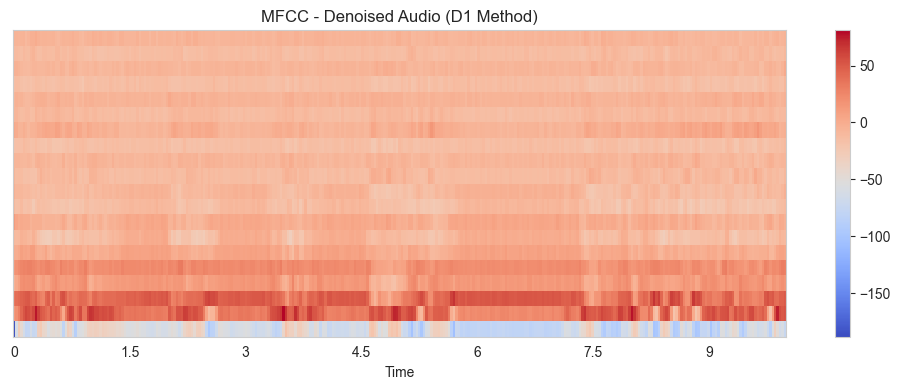

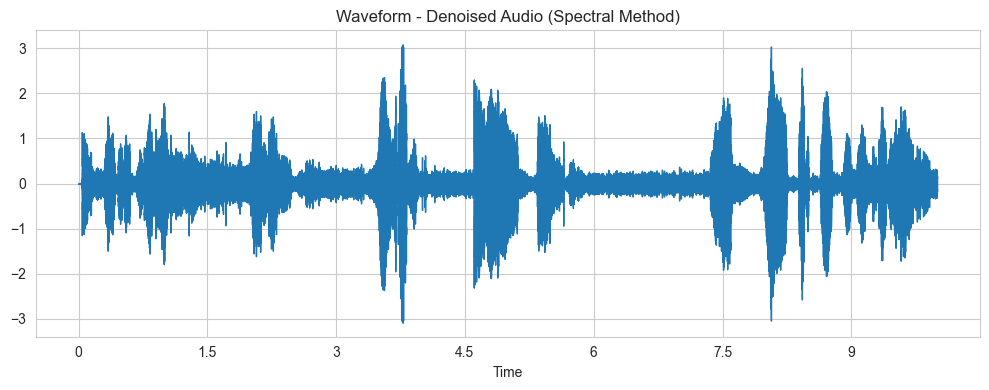

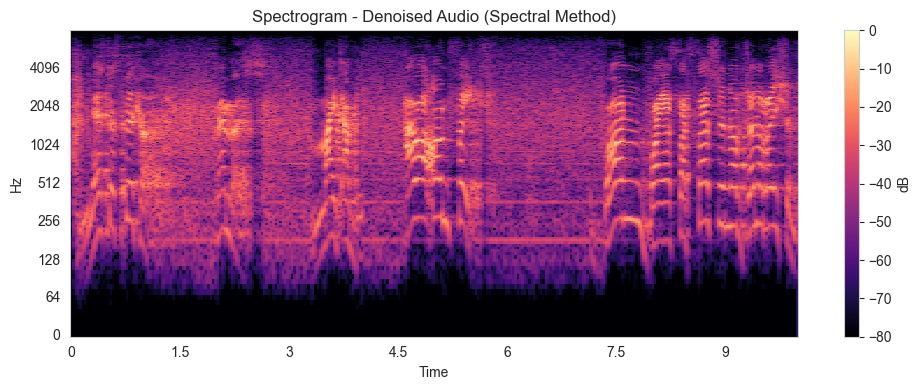

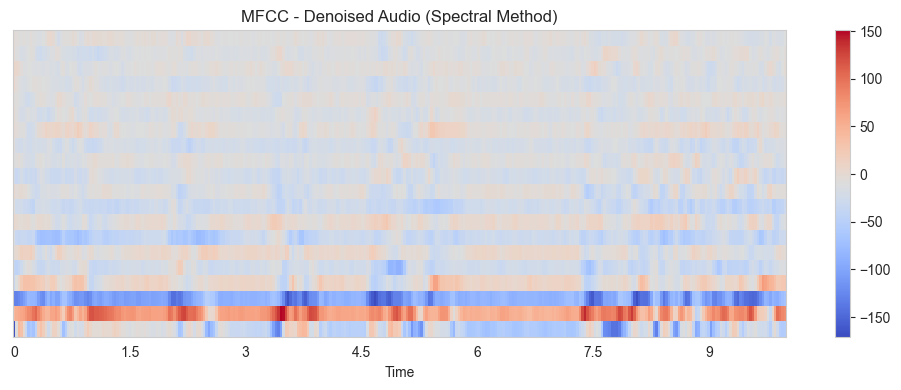

In [16]:
def merge_audios(audio_files):
    audios = [lib.load(file, sr=None)[0] for file in audio_files]
    return np.concatenate(audios)

for speaker in speakers:
    speaker_path = os.path.join(base_path, speaker)
    audio_files = [os.path.join(speaker_path, f) for f in sorted(os.listdir(speaker_path))]
    y, sr = merge_audios(audio_files[:10]), 16000

    print(f"Processing audio from class: {speaker}")
    # Visualize raw audio
    display(Audio(data=y, rate=sr))
    plot_audio_wave(y, sr, title="Raw Audio")
    plot_audio_wave_spect(y, sr, title="Raw Audio")
    plot_audio_wave_mfcc(y, sr, title="Raw Audio")

    # Trimming
    y_trimmed, _ = lib.effects.trim(y, top_db=20)
    display(Audio(y_trimmed, rate=sr))
    plot_audio_wave(y_trimmed, sr, title="Trimmed Audio")
    plot_audio_wave_spect(y_trimmed, sr, title="Trimmed Audio")
    plot_audio_wave_mfcc(y_trimmed, sr, title="Trimmed Audio")

    # Removing silence
    y_no_silence = [y_trimmed[start:end] for start, end in lib.effects.split(y_trimmed, top_db=20)]
    y_combined = np.concatenate(y_no_silence)
    display(Audio(y_combined, rate=sr))
    plot_audio_wave(y_combined, sr, title="Audio without Silence")
    plot_audio_wave_spect(y_combined, sr, title="Audio without Silence")
    plot_audio_wave_mfcc(y_combined, sr, title="Audio without Silence")
    
    # Denoising using D1 method
    y_denoised_d1 = denoise_method_d1(y_combined)
    display(Audio(y_denoised_d1, rate=sr))
    plot_audio_wave(y_denoised_d1, sr, title="Denoised Audio (D1 Method)")
    plot_audio_wave_spect(y_denoised_d1, sr, title="Denoised Audio (D1 Method)")
    plot_audio_wave_mfcc(y_denoised_d1, sr, title="Denoised Audio (D1 Method)")

    # Denoising using spectral method
    y_denoised_spectral = denoise_method_spectral(y_combined, sr)
    display(Audio(y_denoised_spectral, rate=sr))
    plot_audio_wave(y_denoised_spectral, sr, title="Denoised Audio (Spectral Method)")
    plot_audio_wave_spect(y_denoised_spectral, sr, title="Denoised Audio (Spectral Method)")
    plot_audio_wave_mfcc(y_denoised_spectral, sr, title="Denoised Audio (Spectral Method)")

    # Extracting MFCCs for raw audio
    mfcc_raw = lib.feature.mfcc(y=y_combined, sr=sr, n_mfcc=20)
    mean_mfcc_raw = mfcc_raw.mean(axis=1)
    data_raw.append([*mean_mfcc_raw, speaker])

    # Extracting MFCCs for processed (denoised) audio
    mfcc_processed = lib.feature.mfcc(y=y_denoised_spectral, sr=sr, n_mfcc=20)
    mean_mfcc_processed = mfcc_processed.mean(axis=1)
    data_processed.append([*mean_mfcc_processed, speaker])


# Additional Content
Additional code and analysis.

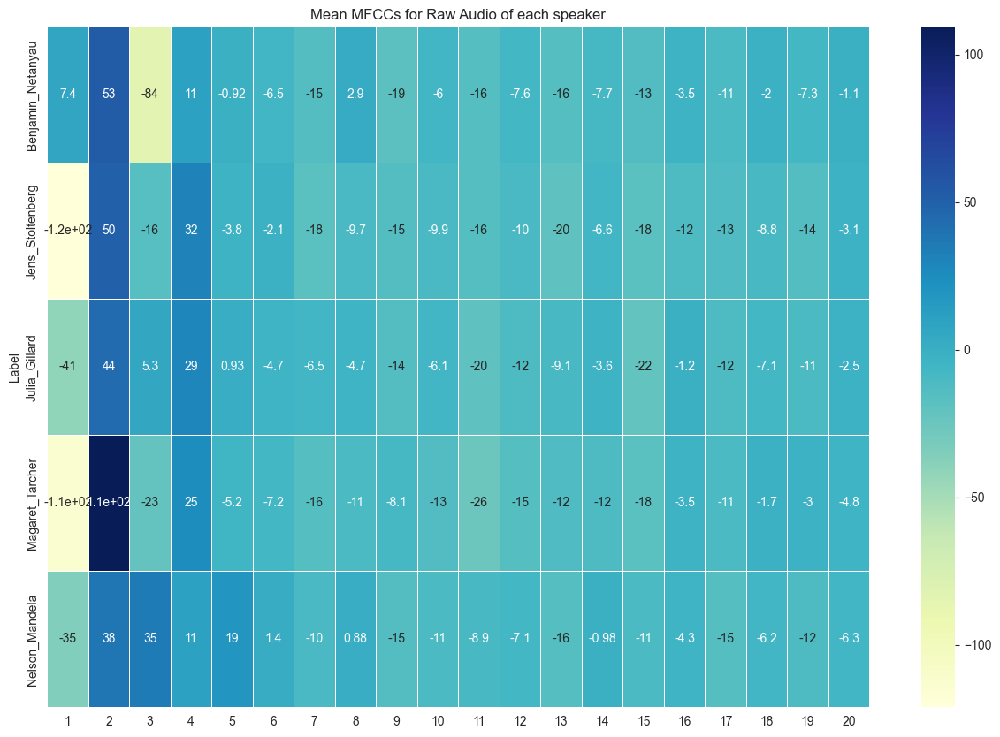

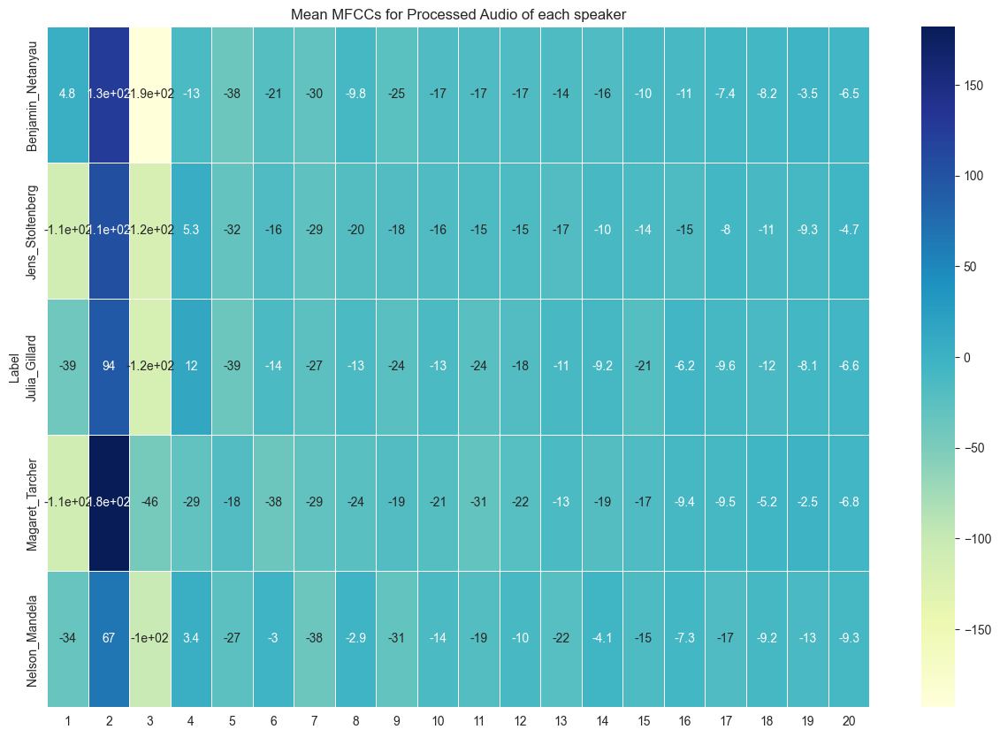

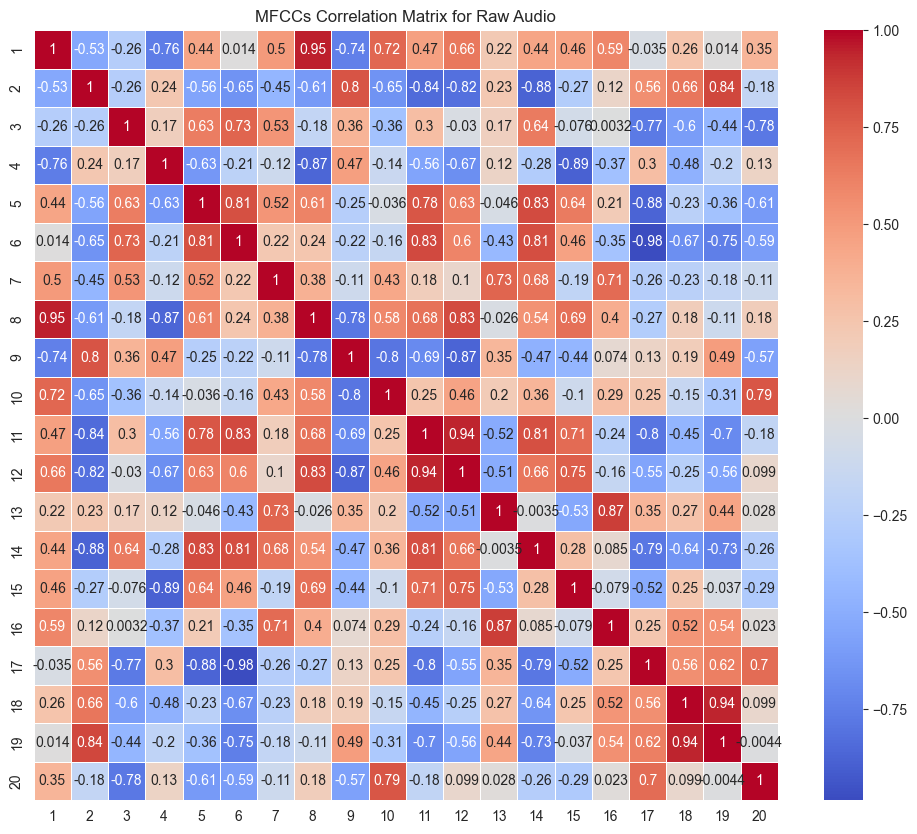

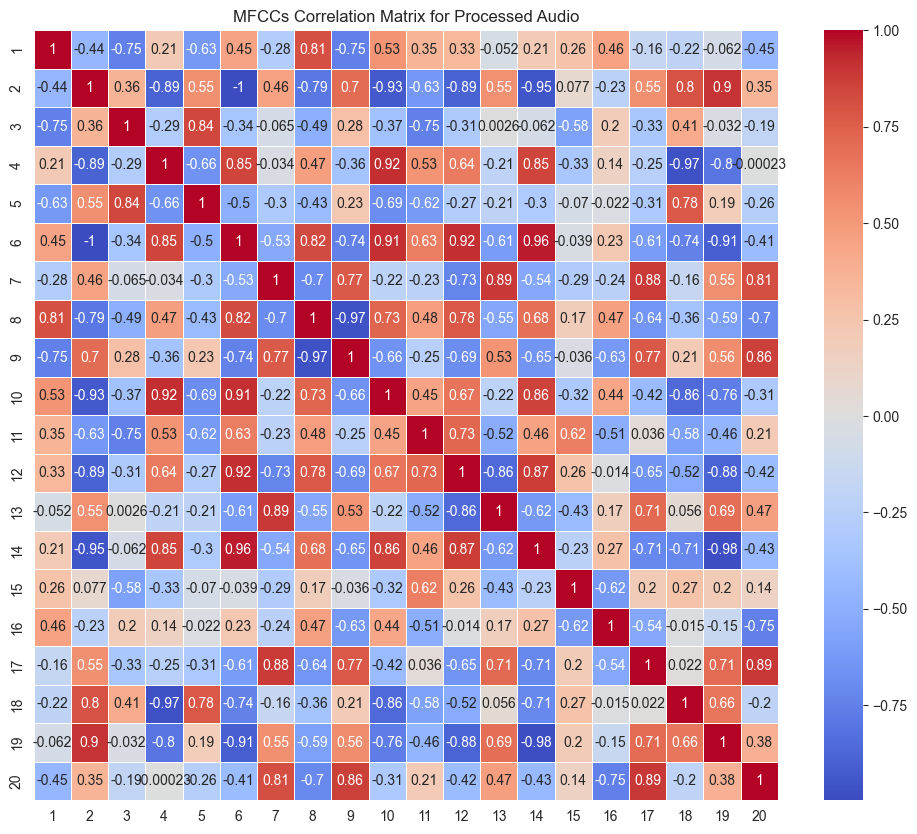

In [17]:
#correlation Matrix

data_raw = []
data_processed = []

base_path = "16000_pcm_speeches"
speakers = ["Benjamin_Netanyau", "Jens_Stoltenberg", "Julia_Gillard", "Magaret_Tarcher", "Nelson_Mandela"]

def merge_audios(audio_files):
    audios = [lib.load(file, sr=None)[0] for file in audio_files]
    return np.concatenate(audios)

def denoise_method_d1(y):
    D = lib.stft(y)
    magnitude, phase = lib.magphase(D)
    magnitude_denoised = lib.decompose.nn_filter(magnitude, aggregate=np.median, metric='cosine')
    y_denoised = lib.istft(magnitude_denoised * phase)
    return y_denoised

def denoise_method_spectral(y, sr):
    # Calculate spectral centroid
    cent = np.mean(lib.feature.spectral_centroid(y=y, sr=sr))
    
    # Low-shelf
    sos = iirfilter(N=2, Wn=cent/sr, btype='low', ftype='butter', output='sos')
    y_low_shelf = sosfilt(sos, y)
    
    # High-shelf
    sos = iirfilter(N=2, Wn=cent/sr, btype='high', ftype='butter', output='sos')
    y_high_shelf = sosfilt(sos, y_low_shelf)
    
    # Amplify signal to compensate for volume reduction
    y_denoised = y_high_shelf * 10
    return y_denoised

for speaker in speakers:
    speaker_path = os.path.join(base_path, speaker)
    audio_files = [os.path.join(speaker_path, f) for f in sorted(os.listdir(speaker_path))]
    
    y, sr = merge_audios(audio_files[:10]), 16000


    # Trimming
    y_trimmed, _ = lib.effects.trim(y, top_db=20)

    # Removing silence
    y_no_silence = [y_trimmed[start:end] for start, end in lib.effects.split(y_trimmed, top_db=20)]
    y_combined = np.concatenate(y_no_silence)

    # Denoising using D1 method
    y_denoised_d1 = denoise_method_d1(y_combined)


    # Denoising using spectral method
    y_denoised_spectral = denoise_method_spectral(y_combined, sr)

    
     # Extracting MFCCs for raw audio
    mfcc_raw = lib.feature.mfcc(y=y_combined, sr=sr, n_mfcc=20)
    mean_mfcc_raw = mfcc_raw.mean(axis=1)
    data_raw.append([*mean_mfcc_raw, speaker])
    
    # Extracting MFCCs for processed (denoised) audio
    mfcc_processed = lib.feature.mfcc(y=y_denoised_spectral, sr=sr, n_mfcc=20)
    mean_mfcc_processed = mfcc_processed.mean(axis=1)
    data_processed.append([*mean_mfcc_processed, speaker])

    

# Raw Audio MFCCs
df_raw = pd.DataFrame(data_raw, columns=[f"{i+1}" for i in range(20)] + ['Label'])
mean_mfccs_raw = df_raw.groupby('Label').mean()
plt.figure(figsize=(15, 10))
sns.heatmap(mean_mfccs_raw, annot=True, cmap="YlGnBu", linewidths=.5)
plt.title("Mean MFCCs for Raw Audio of each speaker")
plt.show()

# Processed Audio MFCCs
df_processed = pd.DataFrame(data_processed, columns=[f"{i+1}" for i in range(20)] + ['Label'])
mean_mfccs_processed = df_processed.groupby('Label').mean()
plt.figure(figsize=(15, 10))
sns.heatmap(mean_mfccs_processed, annot=True, cmap="YlGnBu", linewidths=.5)
plt.title("Mean MFCCs for Processed Audio of each speaker")
plt.show()

# Correlation Matrix for Raw Audio MFCCs
plt.figure(figsize=(12, 10))
sns.heatmap(df_raw.iloc[:, :-1].corr(), annot=True, cmap="coolwarm", linewidths=.5)
plt.title("MFCCs Correlation Matrix for Raw Audio")
plt.show()

# Correlation Matrix for Processed Audio MFCCs
plt.figure(figsize=(12, 10))
sns.heatmap(df_processed.iloc[:, :-1].corr(), annot=True, cmap="coolwarm", linewidths=.5)
plt.title("MFCCs Correlation Matrix for Processed Audio")
plt.show()

# Second Approach

In [18]:

def trim_silence(audio):
    y_trimmed, index = librosa.effects.trim(audio, top_db=20)
    return y_trimmed

def random_5sec_snippet(audio, sample_rate=16000):
    num_samples_for_5sec = 5 * sample_rate
    if len(audio) < num_samples_for_5sec:
        return audio
    start_idx = np.random.randint(0, len(audio) - num_samples_for_5sec)
    return audio[start_idx:start_idx + num_samples_for_5sec]

base_path = "16000_pcm_speeches/"
all_wavs = []
all_labels = []

# Loading speaker wavs
for speaker in os.listdir(base_path):
    if os.path.isdir(base_path + speaker) and speaker != "background_noise" and speaker != "other":
        for file in os.listdir(base_path + speaker):
            wav, _ = librosa.load(base_path + speaker + '/' + file, sr=16000)
            all_wavs.append([wav, len(wav) / 16000])
            all_labels.append(speaker)

# Loading noise wavs
noise_wavs = []
noise_dir = base_path + "_background_noise_/"
for file in os.listdir(noise_dir):
    wav, _ = librosa.load(noise_dir + file, sr=16000)
    noise_wavs.append(wav)

def get_noise_from_sound(signal, noise, SNR):
    RMS_s = np.sqrt(np.mean(signal ** 2))
    RMS_n = np.sqrt(RMS_s ** 2 / (pow(10, SNR / 10)))
    RMS_current = np.sqrt(np.mean(noise ** 2))
    noise = noise * (RMS_n / RMS_current)
    return noise


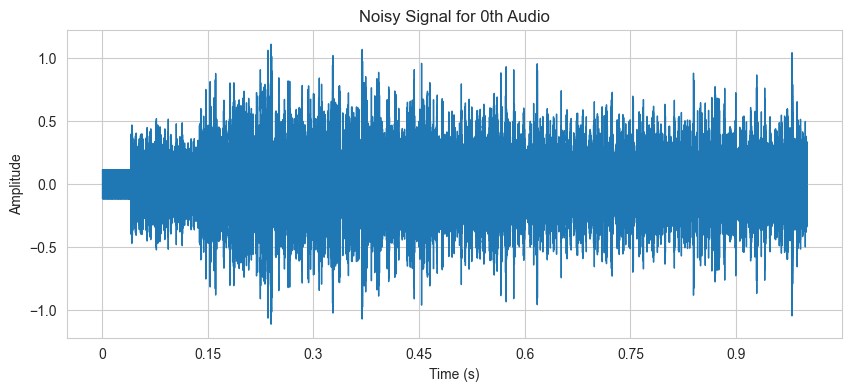

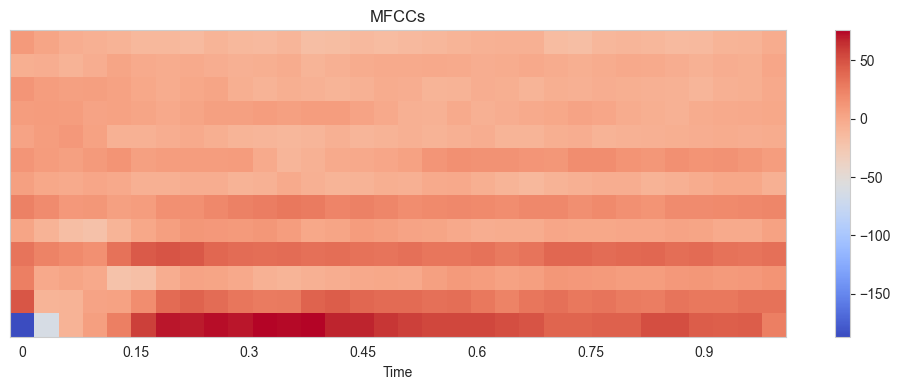

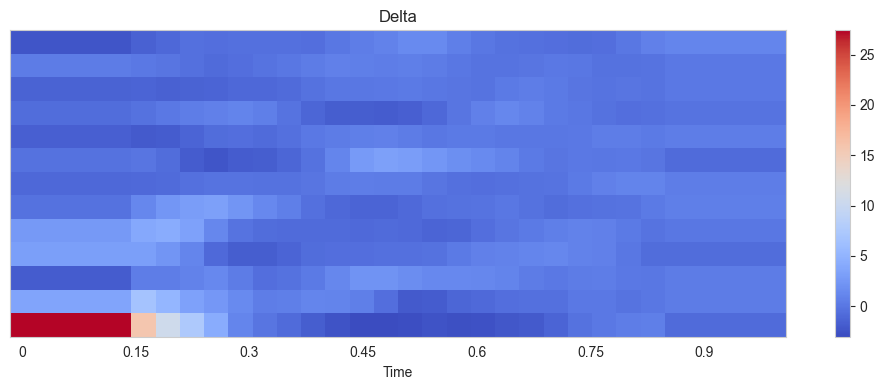

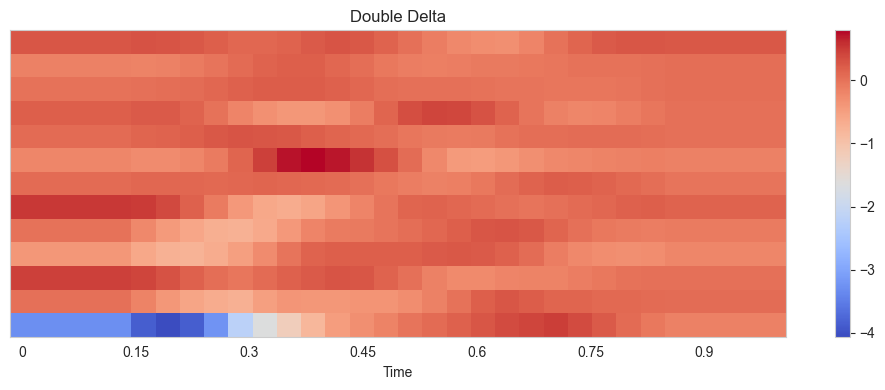

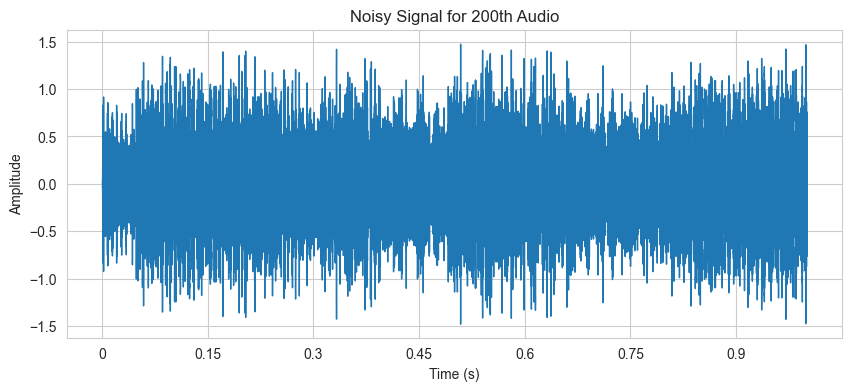

...

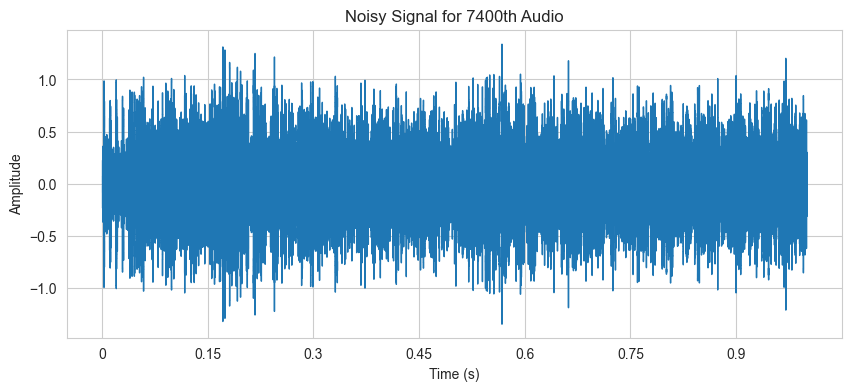

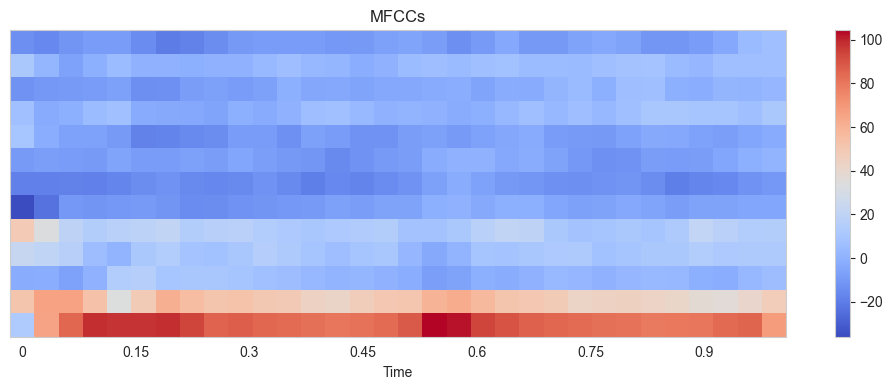

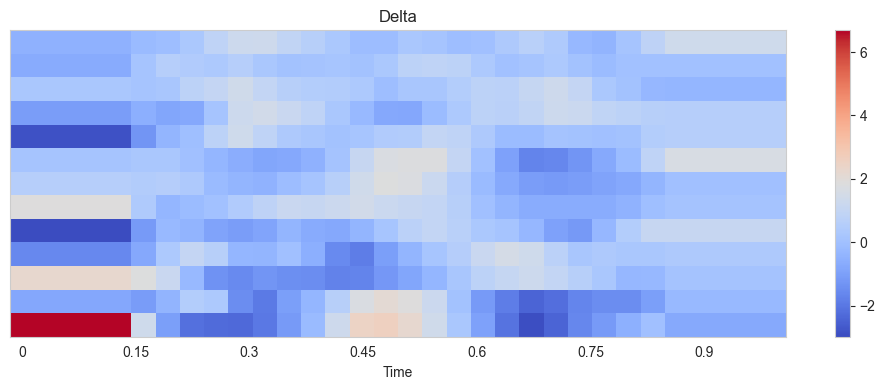

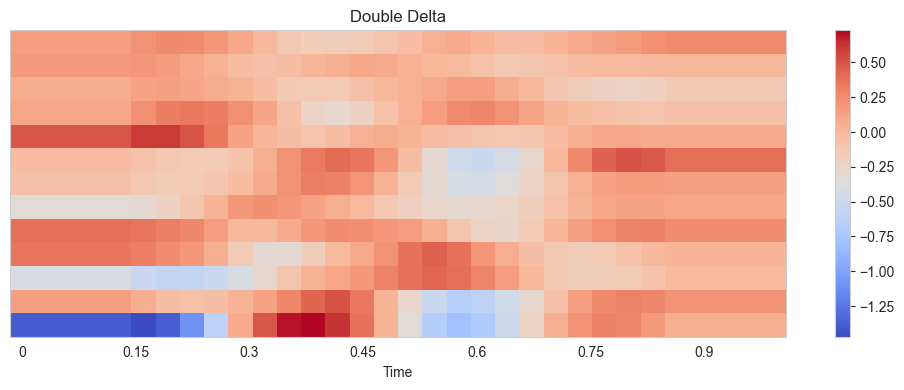

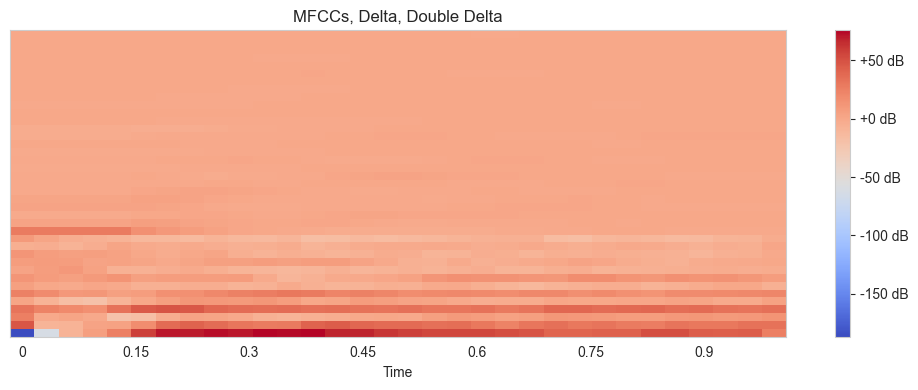

In [19]:
noisy_dataset = []
all_features = []

for i in range(len(all_wavs)):
    signal = np.interp(all_wavs[i][0], (all_wavs[i][0].min(), all_wavs[i][0].max()), (-1, 1))
    
    noise_idx = np.random.randint(0, len(noise_wavs))
    noise = noise_wavs[noise_idx]

    if len(signal) < len(noise):
        noise = get_noise_from_sound(signal, noise, np.random.uniform(0, 10))
        noise = noise[:len(signal)]
    else:
        signal = signal[:len(noise)]
        noise = get_noise_from_sound(signal, noise, np.random.uniform(0, 10))
    noisy = signal + noise
    noisy = random_5sec_snippet(noisy)
    
    # Extract MFCCs, delta, and double delta
    mfccs = librosa.feature.mfcc(y=noisy, sr=16000, n_mfcc=13)
    delta = librosa.feature.delta(mfccs)
    double_delta = librosa.feature.delta(delta)
    
    # Combine into a single feature matrix
    combined = np.vstack((mfccs, delta, double_delta))
    
    noisy_dataset.append([noisy, all_labels[i]])
    all_features.append(combined)
    
    if i % 200 == 0:
        plt.figure(figsize=(10, 4))
        librosa.display.waveshow(noisy, sr=16000)
        plt.title(f"Noisy Signal for {i}th Audio")
        plt.xlabel("Time (s)")
        plt.ylabel("Amplitude")
        plt.show()
        
        # Plot MFCCs
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(mfccs, x_axis='time', sr=16000)
        plt.colorbar()
        plt.title("MFCCs")
        plt.tight_layout()
        plt.show()
        
        # Plot Delta
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(delta, x_axis='time', sr=16000)
        plt.colorbar()
        plt.title("Delta")
        plt.tight_layout()
        plt.show()
        
        # Plot Double Delta
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(double_delta, x_axis='time', sr=16000)
        plt.colorbar()
        plt.title("Double Delta")
        plt.tight_layout()
        plt.show()
        
all_mfccs = []
for i in range(len(noisy_dataset)):
    mfccs = librosa.feature.mfcc(y=noisy_dataset[i][0], sr=16000, n_mfcc=13)
    delta = librosa.feature.delta(mfccs)
    double_delta = librosa.feature.delta(delta)
    combined = np.vstack((mfccs, delta, double_delta))
    all_mfccs.append([combined, noisy_dataset[i][1]])
    if i == 0:
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(combined, x_axis='time', sr=16000)
        plt.colorbar(format="%+2.0f dB")
        plt.title("MFCCs, Delta, Double Delta")
        plt.tight_layout()
        plt.show()

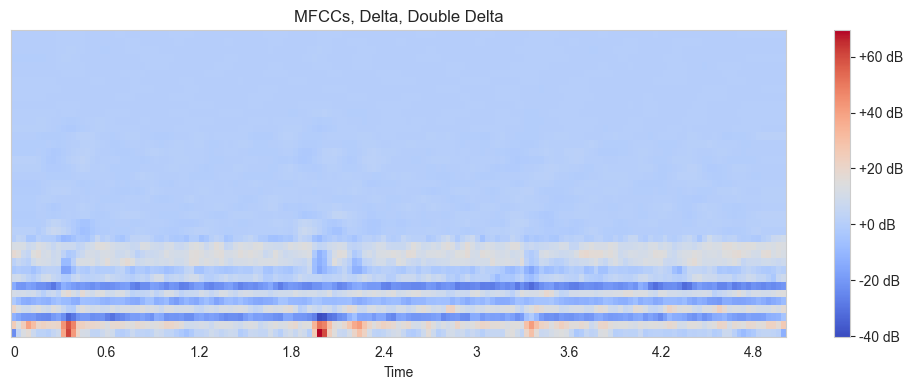

In [20]:
plt.figure(figsize=(10, 4))
librosa.display.specshow(combined, x_axis='time', sr=16000)
plt.colorbar(format="%+2.0f dB")
plt.title("MFCCs, Delta, Double Delta")
plt.tight_layout()
plt.show()

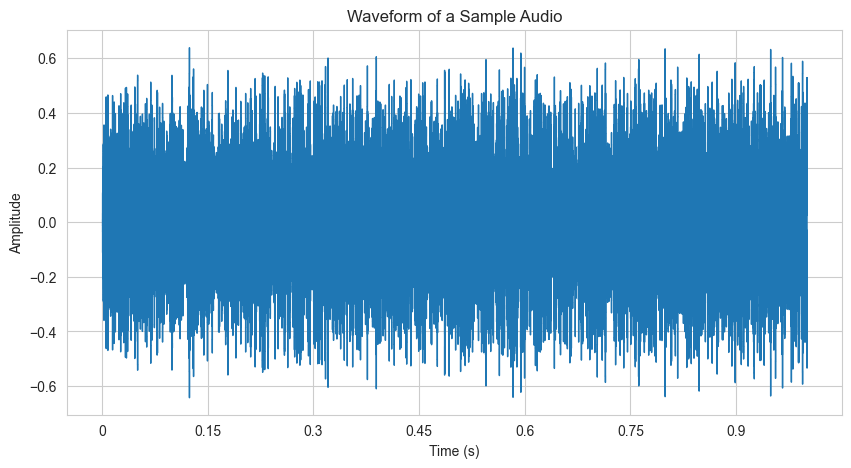

In [22]:

sample_wav = random.choice(all_wavs)
plt.figure(figsize=(10,5))
librosa.display.waveshow(sample_wav[0], sr=16000)
plt.title('Waveform of a Sample Audio')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()


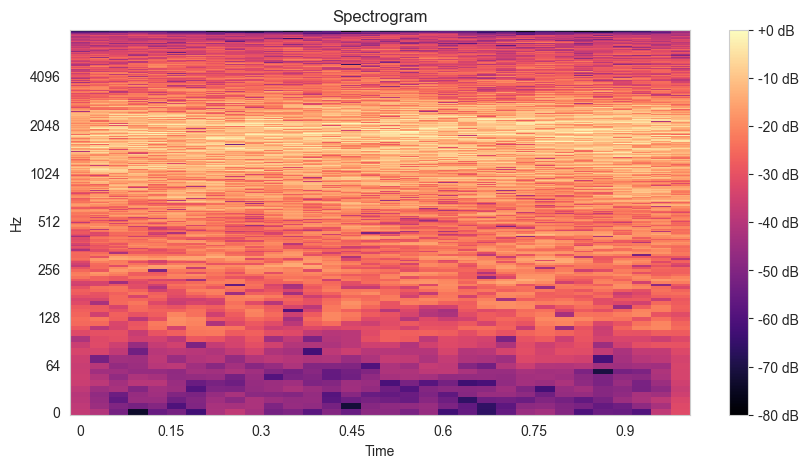

In [23]:

D = librosa.amplitude_to_db(np.abs(librosa.stft(sample_wav[0])), ref=np.max)
plt.figure(figsize=(10,5))
librosa.display.specshow(D, sr=16000, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram')
plt.show()



## Inferences and Suggestions (Additional Content)

### Mean MFCCs for Raw and Processed Audio
- **Inference**: These heatmaps help in comparing the feature distributions before and after preprocessing, providing insights into the effectiveness of the preprocessing steps.
- **Suggestion**: Look for patterns or differences that might indicate whether the preprocessing is beneficial. Ensure that the denoising methods are enhancing the audio quality.

### MFCCs Correlation Matrix
- **Inference**: The correlation matrices show the relationships between different MFCC coefficients, helping to identify highly correlated features.
- **Suggestion**: Consider dimensionality reduction techniques if there are redundant features. Analyze the matrices to understand the feature relationships better.



## Explanation of Visualizations

### Waveform of a Sample Audio
- **Description**: The waveform of an audio signal represents the variation of sound pressure with respect to time. It provides a visual representation of the audio signal, showing how the sound pressure varies over time.
- **Significance**: Analyzing the waveform can help in identifying patterns, rhythm, and anomalies in the audio signal. It is crucial for understanding the nature of the audio, detecting noise, and identifying areas that might need preprocessing.

### Spectrogram
- **Description**: A spectrogram is a visual representation of the spectrum of frequencies in a sound signal as they vary with time. It shows how the energy of the audio signal is distributed across different frequencies over time.
- **Significance**: The spectrogram is vital for analyzing the frequency content of the audio signal. It helps in identifying different phonemes, understanding speech patterns, and detecting background noise or interference. In the context of audio processing and analysis, the spectrogram is an essential tool for feature extraction and noise reduction.
